In [1]:
import numpy as np
import pandas as pd
import seaborn as sns

import torch
from torch import nn
from torch.nn import functional as f
from torch.utils.data import TensorDataset, DataLoader


import math
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split


from matplotlib import pyplot as plt

import os
from torchvision.datasets import MNIST
from torchvision import transforms as tfs
from torch.utils.data import Dataset

from torch.optim import lr_scheduler
from IPython.display import clear_output

from matplotlib import pyplot as plt
%matplotlib inline
# КРАСИВЫЕ ГРАФИКИ - КАК СИМВОЛ ПОБЕДЫ, ВЕКТОРНАЯ ПРОРИСОВКА - КАК ОРУДИЕ ВОЙНЫ
%config InlineBackend.figure_format = 'svg' 

device = "cuda" if torch.cuda.is_available() else "cpu"

%load_ext autoreload
%autoreload 2

In [2]:
normal_data = pd.read_csv('Normal_data.csv')
anomaly_data = pd.read_csv('Anomaly_data.csv')

normal_data = normal_data.drop('Unnamed: 0', axis=1)
anomaly_data = anomaly_data.drop('Unnamed: 0', axis=1)

normal_data.dtypes

FIT101     float64
LIT101     float64
AIT201     float64
AIT202     float64
AIT203     float64
FIT201     float64
DPIT301    float64
FIT301     float64
LIT301     float64
AIT401     float64
AIT402     float64
FIT401     float64
LIT401     float64
AIT501     float64
AIT502     float64
AIT503     float64
AIT504     float64
FIT501     float64
FIT502     float64
FIT503     float64
FIT504     float64
PIT501     float64
PIT502     float64
PIT503     float64
FIT601     float64
MV101        int64
P101         int64
P102         int64
MV201        int64
P201         int64
P202         int64
P203         int64
P204         int64
P205         int64
P206         int64
MV301        int64
MV302        int64
MV303        int64
MV304        int64
P301         int64
P302         int64
P401         int64
P402         int64
P403         int64
P404         int64
UV401        int64
P501         int64
P502         int64
P601         int64
P602         int64
P603         int64
dtype: object

In [3]:
state = anomaly_data['Normal/Attack']
anomaly_data = anomaly_data.drop('Normal/Attack', axis=1)

state = np.array(state)

In [4]:
float_columns = ['FIT101', 'LIT101', 'AIT201', 'AIT202', 'AIT203', 'FIT201', 'DPIT301',
       'FIT301', 'LIT301', 'AIT401', 'AIT402', 'FIT401', 'LIT401', 'AIT501',
       'AIT502', 'AIT503', 'AIT504', 'FIT501', 'FIT502', 'FIT503', 'FIT504',
       'PIT501', 'PIT502', 'PIT503', 'FIT601']

anomaly_data.columns = normal_data.columns

float_idx = []
for i in float_columns:
    float_idx.append(normal_data.columns.get_loc(i))

float_idx = np.array(float_idx)

In [5]:
scaler = StandardScaler()
normal_data[float_columns] = scaler.fit_transform(normal_data[float_columns])

anomaly_data[float_columns] = scaler.transform(anomaly_data[float_columns])

normal_data = np.array(normal_data)
anomaly_data = np.array(anomaly_data)

normal_data[:, float_idx].shape

(49500, 25)

In [6]:
normal_data[:, 25:][normal_data[:, 25:] == 1] = 0
normal_data[:, 25:][normal_data[:, 25:] == 2] = 1

anomaly_data[:, 25:][anomaly_data[:, 25:] == 1] = 0
anomaly_data[:, 25:][anomaly_data[:, 25:] == 2] = 1

In [7]:
prediction_columns = ['FIT101', 'LIT101', 'LIT301']

normal_data_check = pd.read_csv('Normal_data.csv')

prediction_idx = []
for i in prediction_columns:
    prediction_idx.append(normal_data_check.columns.get_loc(i))

prediction_idx = np.sort(prediction_idx) - 1
prediction_idx

array([0, 1, 8])

In [8]:
class SWaT_Dataset_Autoformer_TCN(Dataset):
  def __init__(self, dataset, seq_len=96, classes=51):
    self.dataset = dataset
    self.len = dataset.shape[0] - seq_len 
    self.seq_len = seq_len
    self.classes = classes

  def __len__(self):
    return self.len

  def __getitem__(self, idx):
    x, y = self.dataset[idx: idx + self.seq_len], self.dataset[idx + 1: idx + self.seq_len + 1]
    return x.reshape(-1, self.classes), y.reshape(-1, self.classes)

In [9]:
#normal_data.shape
train_data = normal_data[: 31500]
test_data = normal_data[31500: ]

train_data.shape

(31500, 51)

In [10]:
train_check = SWaT_Dataset_Autoformer_TCN(train_data[:, prediction_idx], 400, 3)
test_check = SWaT_Dataset_Autoformer_TCN(test_data[:, prediction_idx], 400, 3)

In [ ]:
from TCN import AutoRegressiveTCN

dropout = 0.1
kernel_size = 7
n = 8
hidden_channels = 128
r_seed = 42

input_channels = 3
n_classes = 3 * 5 * 3
channel_sizes = [hidden_channels] * n

device = "cuda" if torch.cuda.is_available() else "cpu"
model_TCN = AutoRegressiveTCN(input_channels, n_classes, channel_sizes, kernel_size=kernel_size, dropout=dropout).to(device)

lr = 1e-4
epochs = 10

batch_size = 64
train_dataloader = DataLoader(train_check, shuffle=True, batch_size=batch_size)
test_dataloader = DataLoader(test_check, shuffle=False, batch_size=batch_size)

In [ ]:
model_TCN.load_state_dict(torch.load('/content/TCN_SWaT_prob'))

<All keys matched successfully>

In [ ]:
r = []
g = []
u = []
d = []
x, y = test_check[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :]
model_TCN.eval()
for i in range(50):
  _, y = test_check[i]
  result = model_TCN(x)
  output = result.reshape(-1, 400, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  varp = var[0, -1, :]
  exp = expect[0, -1, :]
  temp_q_20 = []
  temp_q_80 = []
  for i in range(3):
    expi = exp[i].item()
    vari = varp[i].item()
    #print(vari)
    #sample = np.random.normal(expi, vari, 200)
    #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
    #print(q_20 - q_80, i)
    #temp_q_20.append(q_20)
    #temp_q_80.append(q_80)
    temp_q_20.append(expi)
    temp_q_80.append(vari)
  #result = torch.normal(expect, var)
  result = expect
  x = torch.cat((x, result[0, -1, :][None, None, :]), dim=1)
  x = x[:, 1:, :]
  r.append(result[0, -1, :].cpu().detach().numpy())
  g.append(y[-1, :])
  d.append(temp_q_20)
  u.append(temp_q_80)

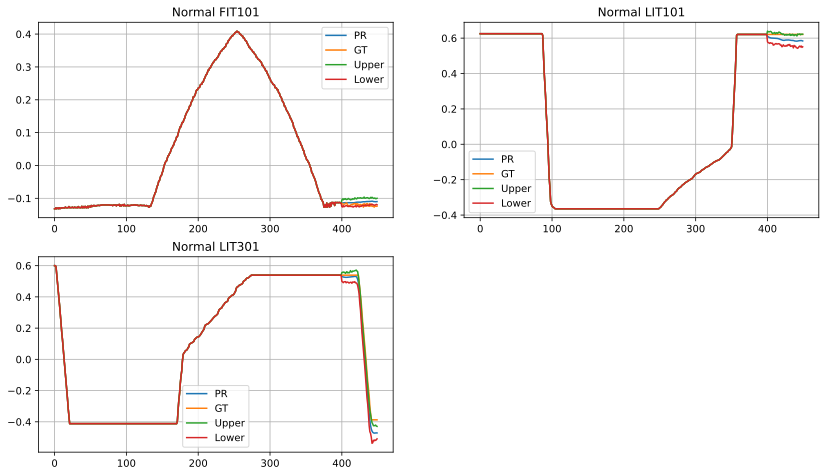

In [ ]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 200)
      q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
u = np.array(new_u)
d = np.array(new_d)


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:, 0]], label='PR')
plt.plot([*o[:, 0], *g[:, 0]], label='GT')
plt.plot([*o[:, 0], *u[:, 0]], label='Upper')
plt.plot([*o[:, 0], *d[:, 0]], label='Lower')
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:, 1]], label='PR')
plt.plot([*o[:, 1], *g[:, 1]], label='GT')
plt.plot([*o[:, 1], *u[:, 1]], label='Upper')
plt.plot([*o[:, 1], *d[:, 1]], label='Lower')
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:, 2]], label='PR')
plt.plot([*o[:, 2], *g[:, 2]], label='GT')
plt.plot([*o[:, 2], *u[:, 2]], label='Upper')
plt.plot([*o[:, 2], *d[:, 2]], label='Lower')
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [ ]:
r = []
g = []
u = []
d = []
x, y = test_check[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :]
model_TCN.eval()
for i in range(len(test_check)):
  _, y = test_check[i]
  if i % 20 == 0:
    x, _ = test_check[i]
    x = torch.Tensor(x).to(device)[None, :, :]
  result = model_TCN(x)
  output = result.reshape(-1, 400, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  varp = var[0, -1, :]
  exp = expect[0, -1, :]
  temp_q_20 = []
  temp_q_80 = []
  for i in range(3):
    expi = exp[i].item()
    vari = varp[i].item()
    #print(vari)
    #sample = np.random.normal(expi, vari, 200)
    #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
    #print(q_20 - q_80, i)
    #temp_q_20.append(q_20)
    #temp_q_80.append(q_80)
    temp_q_20.append(expi)
    temp_q_80.append(vari)
  #result = torch.normal(expect, var)
  result = expect
  x = torch.cat((x, result[0, -1, :][None, None, :]), dim=1)
  x = x[:, 1:, :]
  r.append(result[0, -1, :].cpu().detach().numpy())
  g.append(y[-1, :])
  d.append(temp_q_20)
  u.append(temp_q_80)

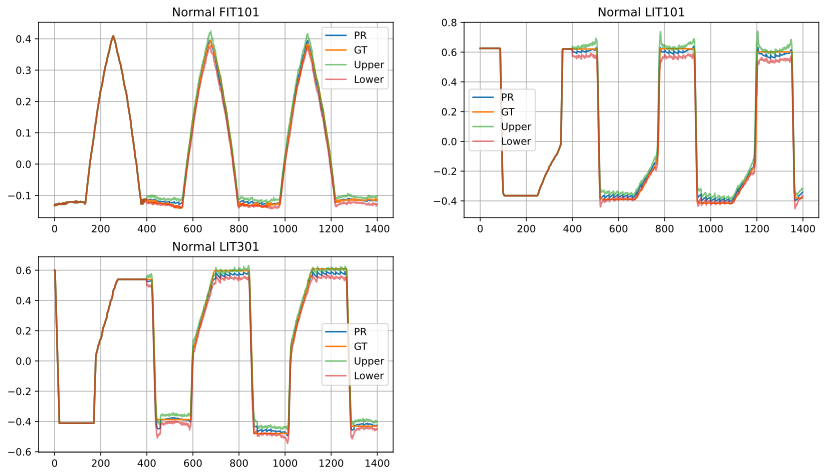

In [ ]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:1000, 0]], label='PR')
plt.plot([*o[:, 0], *g[:1000, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:1000, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:1000, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:1000, 1]], label='PR')
plt.plot([*o[:, 1], *g[:1000, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:1000, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:1000, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:1000, 2]], label='PR')
plt.plot([*o[:, 2], *g[:1000, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:1000, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:1000, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [ ]:
anomaly_check = SWaT_Dataset_Autoformer_TCN(anomaly_data[:, prediction_idx], 400, 3)

In [ ]:
r_anomaly = []
g_anomaly = []
u = []
d = []
x, y = anomaly_check[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :]
for i in range(len(anomaly_check)):
  _, y = anomaly_check[i]
  if i % 20 == 0:
    x, _ = anomaly_check[i]
    x = torch.Tensor(x).to(device)[None, :, :]
  result = model_TCN(x)
  output = result.reshape(-1, 400, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  varp = var[0, -1, :]
  exp = expect[0, -1, :]
  temp_q_20 = []
  temp_q_80 = []
  for i in range(3):
    expi = exp[i].item()
    vari = varp[i].item()
    #print(vari)
    #sample = np.random.normal(expi, vari, 200)
    #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
    #print(q_20 - q_80, i)
    #temp_q_20.append(q_20)
    #temp_q_80.append(q_80)
    temp_q_20.append(expi)
    temp_q_80.append(vari)
  #result = torch.normal(expect, var)
  result = expect
  x = torch.cat((x, result[0, -1, :][None, None, :]), dim=1)
  x = x[:, 1:, :]
  r_anomaly.append(result[0, -1, :].cpu().detach().numpy())
  g_anomaly.append(y[-1, :])
  d.append(temp_q_20)
  u.append(temp_q_80)

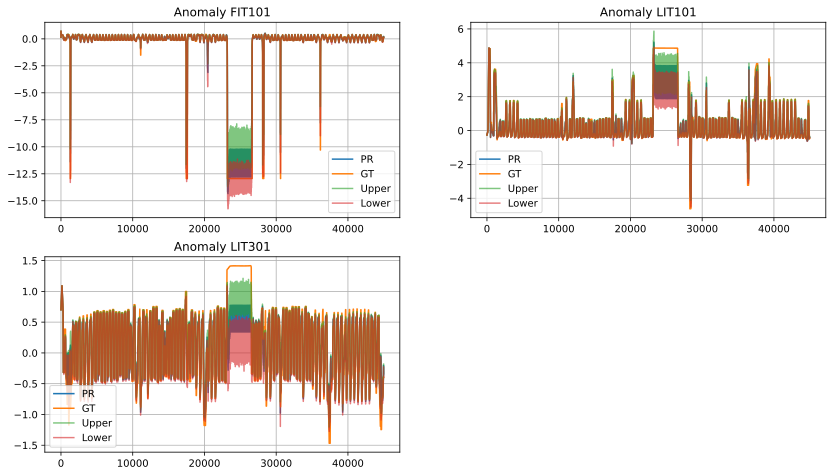

In [ ]:
g = np.array(g_anomaly)
r = np.array(r_anomaly)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:, 0]], label='PR')
plt.plot([*o[:, 0], *g[:, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:, 0]], label='Lower', alpha=0.6)
plt.title('Anomaly FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:, 1]], label='PR')
plt.plot([*o[:, 1], *g[:, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:, 1]], label='Lower', alpha=0.6)
plt.title('Anomaly LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:, 2]], label='PR')
plt.plot([*o[:, 2], *g[:, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:, 2]], label='Lower', alpha=0.6)
plt.title('Anomaly LIT301')
plt.legend()
plt.grid()

plt.show()

In [11]:
filling = state * 5
filling[filling == 0] = -13

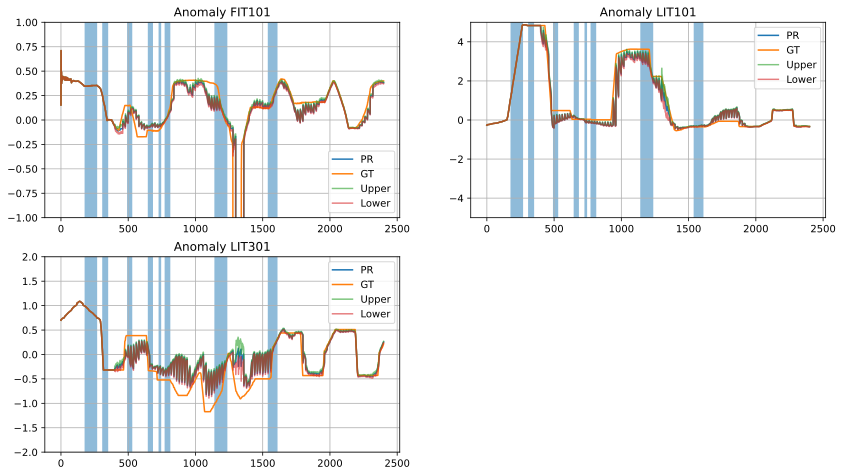

In [ ]:
g = np.array(g_anomaly)
r = np.array(r_anomaly)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

win = 2000


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:win, 0]], label='PR')
plt.plot([*o[:, 0], *g[:win, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:win, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:win, 0]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly FIT101')
plt.legend()
plt.ylim(-1, 1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:win, 1]], label='PR')
plt.plot([*o[:, 1], *g[:win, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:win, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:win, 1]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT101')
plt.ylim(-5, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:win, 2]], label='PR')
plt.plot([*o[:, 2], *g[:win, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:win, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:win, 2]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT301')
plt.ylim(-2, 2)
plt.legend()
plt.grid()

plt.show()

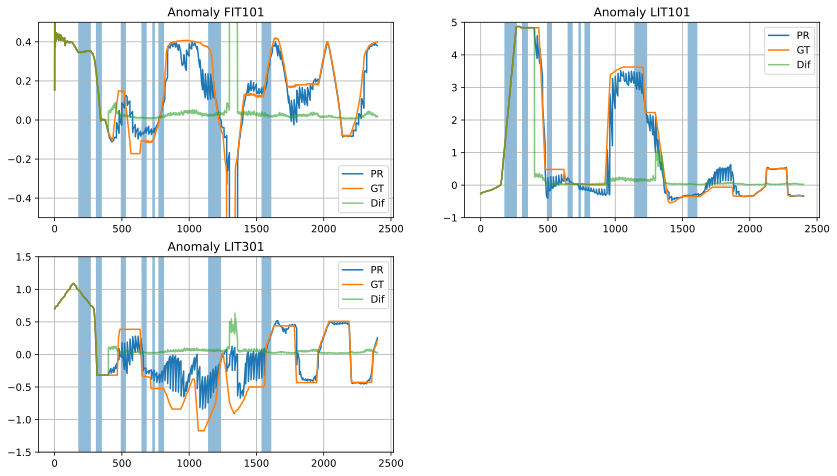

In [ ]:
fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:win, 0]], label='PR')
plt.plot([*o[:, 0], *g[:win, 0]], label='GT')
plt.plot([*o[:, 0], *(new_u[:win, 0] - new_d[:win, 0])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly FIT101')
plt.legend()
plt.ylim(-0.5, 0.5)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:win, 1]], label='PR')
plt.plot([*o[:, 1], *g[:win, 1]], label='GT')
plt.plot([*o[:, 1], *(new_u[:win, 1] - new_d[:win, 1])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT101')
plt.ylim(-1, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:win, 2]], label='PR')
plt.plot([*o[:, 2], *g[:win, 2]], label='GT')
plt.plot([*o[:, 2], *(new_u[:win, 2] - new_d[:win, 2])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT301')
plt.ylim(-1.5, 1.5)
plt.legend()
plt.grid()

plt.show()

In [ ]:
win=20000
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*(new_u[:win, 0] - new_d[:win, 0])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Dif')
plt.legend()
plt.ylim(-0.5, 0.5)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*(new_u[:win, 1] - new_d[:win, 1])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Dif')
plt.ylim(-1, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*(new_u[:win, 2] - new_d[:win, 2])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Dif')
plt.ylim(-1.5, 1.5)
plt.legend()
plt.grid()

plt.show()

In [12]:
from sklearn.metrics import recall_score, precision_score, f1_score
from tqdm import tqdm


In [ ]:
from sklearn.metrics import recall_score, precision_score, f1_score
from tqdm import tqdm

best_f1_fit101 = 0
best_f1_lit101 = 0
best_f1_lit301 = 0

fit101_thresh = 0
lit101_thresh = 0
lit301_thresh = 0

state_check = state[400: 20400]

for a, b, c in tqdm(zip([*(new_u[:win, 0] - new_d[:win, 0])], [*(new_u[:win, 1] - new_d[:win, 1])], [*(new_u[:win, 2] - new_d[:win, 2])])):
  f1_fit101 = f1_score(state_check, np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > a)
  f1_lit101 = f1_score(state_check, np.array([*(new_u[:win, 1] - new_d[:win, 1])]) > b)
  f1_lit301 = f1_score(state_check, np.array([*(new_u[:win, 2] - new_d[:win, 2])]) > c)

  if f1_fit101 > best_f1_fit101:
    best_f1_fit101 = f1_fit101
    fit101_thresh = a
  
  if f1_lit101 > best_f1_lit101:
    best_f1_lit101 = f1_lit101
    lit101_thresh = b
  
  if f1_lit301 > best_f1_lit301:
    best_f1_lit301 = f1_lit301
    lit301_thresh = c

20000it [07:28, 44.58it/s]


In [ ]:
fit101_thresh = 0.08
lit101_thresh = 0.2
lit301_thresh = 0.1

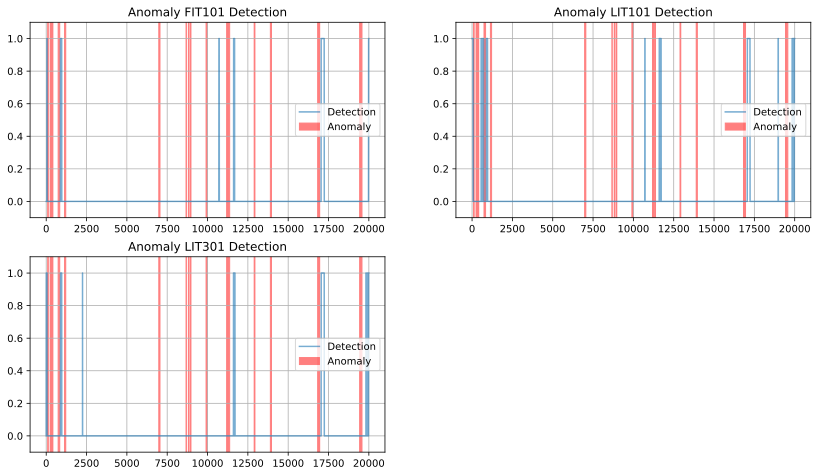

In [ ]:
win=20000
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot(np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Detection')
plt.legend()
plt.ylim(-0.1, 1.1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot(np.array([*(new_u[:win, 1] - new_d[:win, 1])]) > lit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot(np.array([*(new_u[:win, 2] - new_d[:win, 2])]) > lit301_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

plt.show()

In [ ]:
win=filling.shape[0] - 400
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot(np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Detection')
plt.legend()
plt.ylim(-0.1, 1.1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot(np.array([*(new_u[:win, 1] - new_d[:win, 1])]) > lit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot(np.array([*(new_u[:win, 2] - new_d[:win, 2])]) > lit301_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

plt.show()

In [ ]:
y_pred = np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh
y_true = state[:y_pred.shape[0]]

fit101_f1 = f1_score(y_true, y_pred)
fit101_precision = precision_score(y_true, y_pred)
fit101_recall = recall_score(y_true, y_pred)

print('FIT101_F1_SCORE: ', fit101_f1)
print('FIT101_PRECISION_SCORE: ', fit101_precision)
print('FIT101_RECALL_SCORE: ', fit101_recall)

FIT101_F1_SCORE:  0.7147507629704984
FIT101_PRECISION_SCORE:  0.8053645116918845
FIT101_RECALL_SCORE:  0.6424652523774689


In [13]:
class SWaT_Dataset_Autoformer(Dataset):
  def __init__(self, dataset, pred_len=12, seq_len=96, classes=51):
    self.dataset = dataset
    self.len = dataset.shape[0] -  pred_len - seq_len + 1 
    self.pred_len = pred_len
    self.seq_len = seq_len
    self.classes = classes

  def __len__(self):
    return self.len

  def __getitem__(self, idx):
    x, y = self.dataset[idx: idx + self.seq_len], self.dataset[idx + self.seq_len: idx + self.seq_len + self.pred_len]
    return x.reshape(self.seq_len, self.classes), y.reshape(self.pred_len, self.classes)

In [14]:
train_dataset = SWaT_Dataset_Autoformer(train_data[:, prediction_idx], 10, 400, 3)
test_dataset = SWaT_Dataset_Autoformer(test_data[:, prediction_idx], 10, 400, 3)

In [88]:
from AutoFormer import AutoFormerSWaT, AutoFormer

device = "cuda" if torch.cuda.is_available() else "cpu"
model_AF = AutoFormerSWaT(seq_len=400, label_len=400, pred_len=10, input_dim=3, d_model=256, classes=3 * 5 * 3)
model_AF.to(device)

batch_size = 64
train_dataloader = DataLoader(train_dataset, shuffle=True, batch_size=batch_size)
test_dataloader = DataLoader(test_dataset, shuffle=False, batch_size=batch_size)

In [89]:
model_AF.load_state_dict(torch.load('/content/AF_SWaT_prob'))

<All keys matched successfully>

In [93]:
r = []
g = []
u = []
d = []
x, y = test_dataset[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :].double()
model_AF.eval()
for k in range(1):
  _, y = test_dataset[k*10]
  result, _ = model_AF(x)
  output = result.reshape(-1, 10, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  temp_q_20 = []
  temp_q_80 = []
  for b in range(10):
    varp = var[0, -1, :]
    exp = expect[0, -1, :]
    temp_q_20_t = []
    temp_q_80_t = []
    for i in range(3):
      expi = exp[i].item()
      vari = varp[i].item()
      #print(vari)
      #sample = np.random.normal(expi, vari, 200)
      #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      #print(q_20 - q_80, i)
      #temp_q_20_t.append(q_20)
      #temp_q_80_t.append(q_80)
      temp_q_20_t.append(expi)
      temp_q_80_t.append(vari)
    
    temp_q_20.append(temp_q_20_t)
    temp_q_80.append(temp_q_80_t)
  #result = torch.normal(expect, var)
  result = expect
  d.append(temp_q_20)
  u.append(temp_q_80)
  x = torch.cat((x, result), dim=1)
  x = x[:, 10:, :]
  r.append(result.cpu().detach().numpy())
  g.append(y)

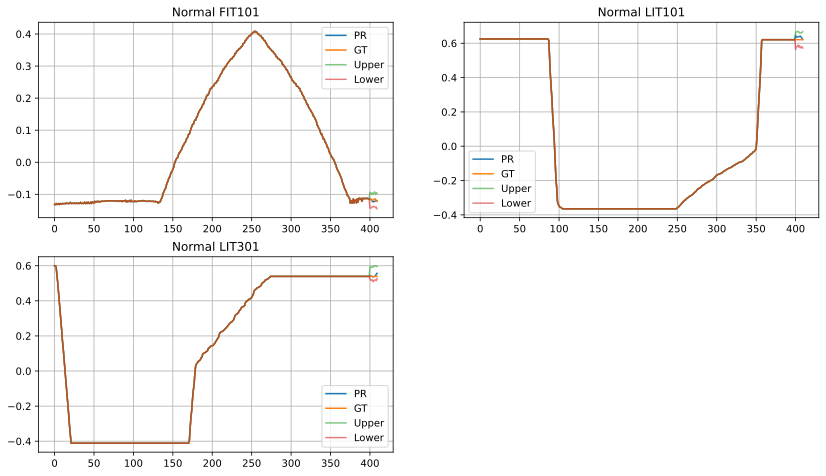

In [97]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

r = r.reshape(10, 3)
g = g.reshape(10, 3)
u = u.reshape(10, 3)
d = d.reshape(10, 3)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.1, 0.9])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:1000, 0]], label='PR')
plt.plot([*o[:, 0], *g[:1000, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:1000, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:1000, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:1000, 1]], label='PR')
plt.plot([*o[:, 1], *g[:1000, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:1000, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:1000, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:1000, 2]], label='PR')
plt.plot([*o[:, 2], *g[:1000, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:1000, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:1000, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [98]:
r = []
g = []
u = []
d = []
x, y = test_dataset[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :].double()
for i in range(len(test_check) // 10):
  if i % 2 == 0:
    x, _ = test_dataset[i*10]
    x = torch.Tensor(x).to(device)[None, :, :].double()
  _, y = test_dataset[i*10]
  result, _ = model_AF(x)
  output = result.reshape(-1, 10, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  temp_q_20 = []
  temp_q_80 = []
  for b in range(10):
    varp = var[0, -1, :]
    exp = expect[0, -1, :]
    temp_q_20_t = []
    temp_q_80_t = []
    for i in range(3):
      expi = exp[i].item()
      vari = varp[i].item()
      #print(vari)
      #sample = np.random.normal(expi, vari, 200)
      #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      #print(q_20 - q_80, i)
      #temp_q_20_t.append(q_20)
      #temp_q_80_t.append(q_80)
      temp_q_20_t.append(expi)
      temp_q_80_t.append(vari)
    
    temp_q_20.append(temp_q_20_t)
    temp_q_80.append(temp_q_80_t)
  #result = torch.normal(expect, var)
  result = expect
  #if result[0, -1, -1] > 0:
  #  result[0, -1, -1] = 0
  #else:
  #  result[0, -1, -1] = 0
  x = torch.cat((x, result), dim=1)
  x = x[:, 10:, :]
  r.append(result.cpu().detach().numpy())
  g.append(y)
  d.append(temp_q_20)
  u.append(temp_q_80)

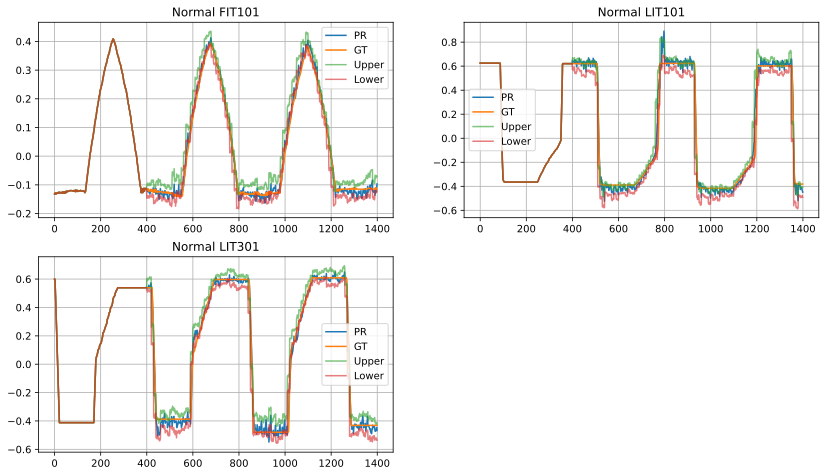

In [100]:
g = np.array(g).reshape(-1, 3)
r = np.array(r).reshape(-1, 3)
u = np.array(u).reshape(-1, 3)
d = np.array(d).reshape(-1, 3)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.1, 0.9])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:1000, 0]], label='PR')
plt.plot([*o[:, 0], *g[:1000, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:1000, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:1000, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:1000, 1]], label='PR')
plt.plot([*o[:, 1], *g[:1000, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:1000, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:1000, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:1000, 2]], label='PR')
plt.plot([*o[:, 2], *g[:1000, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:1000, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:1000, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

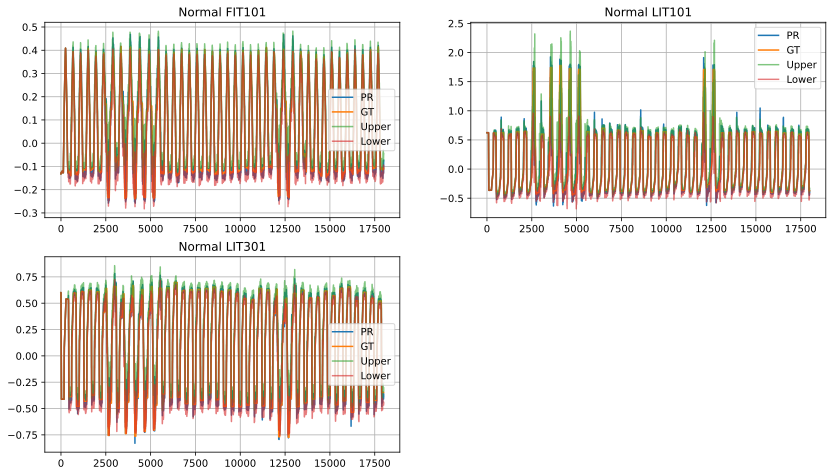

In [101]:
fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:, 0]], label='PR')
plt.plot([*o[:, 0], *g[:, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:, 1]], label='PR')
plt.plot([*o[:, 1], *g[:, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:, 2]], label='PR')
plt.plot([*o[:, 2], *g[:, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [15]:
anomaly_dataset = SWaT_Dataset_Autoformer(anomaly_data[:, prediction_idx], 10, 400, 3)

In [114]:
r = []
g = []
u = []
d = []
x, y = anomaly_dataset[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :].double()
for i in range(len(anomaly_dataset) // 10):
  if i % 2 == 0:
    x, _ = anomaly_dataset[i*10]
    x = torch.Tensor(x).to(device)[None, :, :].double()
  _, y = anomaly_dataset[i*10]
  result, _ = model_AF(x)
  output = result.reshape(-1, 10, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  temp_q_20 = []
  temp_q_80 = []
  for b in range(10):
    varp = var[0, -1, :]
    exp = expect[0, -1, :]
    temp_q_20_t = []
    temp_q_80_t = []
    for i in range(3):
      expi = exp[i].item()
      vari = varp[i].item()
      #print(vari)
      #sample = np.random.normal(expi, vari, 200)
      #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      #print(q_20 - q_80, i)
      #temp_q_20_t.append(q_20)
      #temp_q_80_t.append(q_80)
      temp_q_20_t.append(expi)
      temp_q_80_t.append(vari)
    
    temp_q_20.append(temp_q_20_t)
    temp_q_80.append(temp_q_80_t)
  #result = torch.normal(expect, var)
  result = expect
  #if result[0, -1, -1] > 0:
  #  result[0, -1, -1] = 0
  #else:
  #  result[0, -1, -1] = 0
  x = torch.cat((x, result), dim=1)
  x = x[:, 10:, :]
  r.append(result.cpu().detach().numpy())
  g.append(y)
  d.append(temp_q_20)
  u.append(temp_q_80)

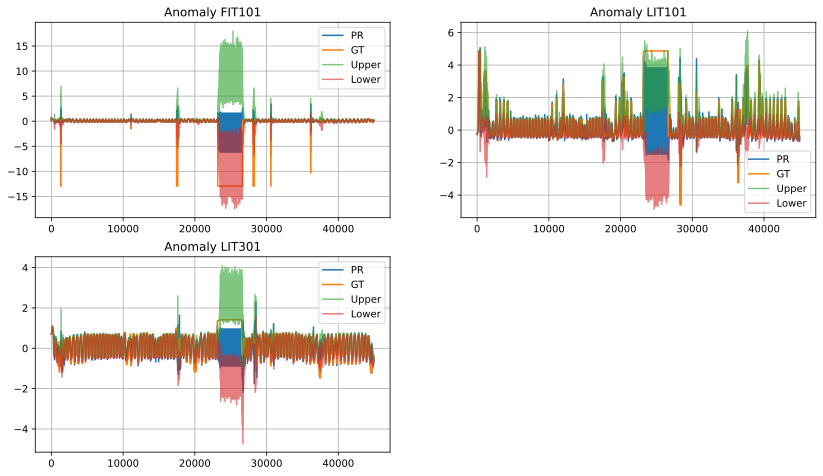

In [115]:
g = np.array(g).reshape(-1, 3)
r = np.array(r).reshape(-1, 3)
u = np.array(u).reshape(-1, 3)
d = np.array(d).reshape(-1, 3)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:, 0]], label='PR')
plt.plot([*o[:, 0], *g[:, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:, 0]], label='Lower', alpha=0.6)
plt.title('Anomaly FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:, 1]], label='PR')
plt.plot([*o[:, 1], *g[:, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:, 1]], label='Lower', alpha=0.6)
plt.title('Anomaly LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:, 2]], label='PR')
plt.plot([*o[:, 2], *g[:, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:, 2]], label='Lower', alpha=0.6)
plt.title('Anomaly LIT301')
plt.legend()
plt.grid()

plt.show()

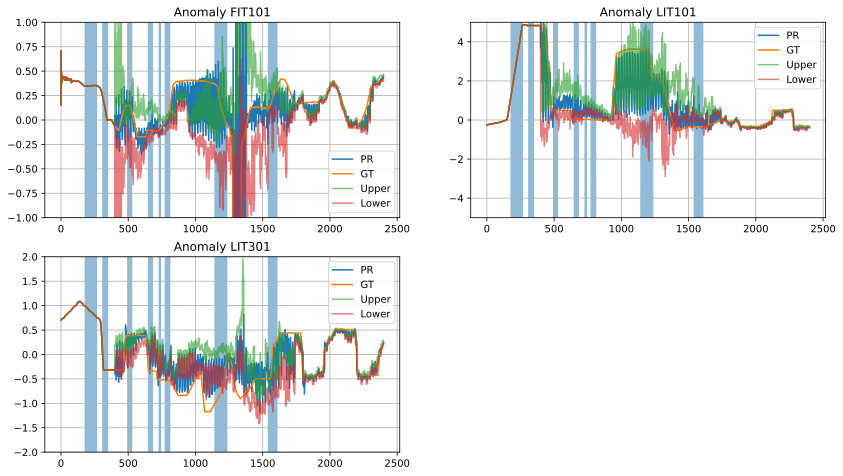

In [116]:
win = 2000


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:win, 0]], label='PR')
plt.plot([*o[:, 0], *g[:win, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:win, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:win, 0]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly FIT101')
plt.legend()
plt.ylim(-1, 1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:win, 1]], label='PR')
plt.plot([*o[:, 1], *g[:win, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:win, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:win, 1]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT101')
plt.ylim(-5, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:win, 2]], label='PR')
plt.plot([*o[:, 2], *g[:win, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:win, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:win, 2]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT301')
plt.ylim(-2, 2)
plt.legend()
plt.grid()

plt.show()

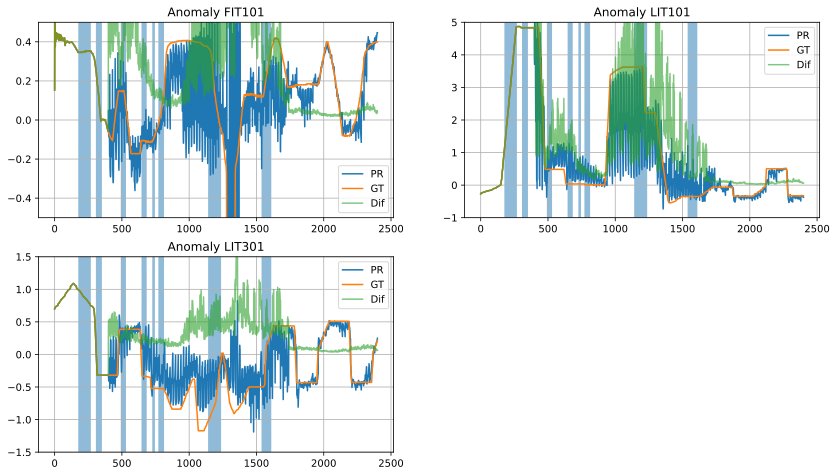

In [117]:
fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:win, 0]], label='PR')
plt.plot([*o[:, 0], *g[:win, 0]], label='GT')
plt.plot([*o[:, 0], *(new_u[:win, 0] - new_d[:win, 0])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly FIT101')
plt.legend()
plt.ylim(-0.5, 0.5)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:win, 1]], label='PR')
plt.plot([*o[:, 1], *g[:win, 1]], label='GT')
plt.plot([*o[:, 1], *(new_u[:win, 1] - new_d[:win, 1])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT101')
plt.ylim(-1, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:win, 2]], label='PR')
plt.plot([*o[:, 2], *g[:win, 2]], label='GT')
plt.plot([*o[:, 2], *(new_u[:win, 2] - new_d[:win, 2])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT301')
plt.ylim(-1.5, 1.5)
plt.legend()
plt.grid()

plt.show()

In [118]:
win=20000
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*(new_u[:win, 0] - new_d[:win, 0])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Dif')
plt.legend()
plt.ylim(-0.5, 0.5)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*(new_u[:win, 1] - new_d[:win, 1])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Dif')
plt.ylim(-1, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*(new_u[:win, 2] - new_d[:win, 2])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Dif')
plt.ylim(-1.5, 1.5)
plt.legend()
plt.grid()

plt.show()

In [129]:
fit101_thresh = 0.4
lit101_thresh = 2
lit301_thresh = 0.5

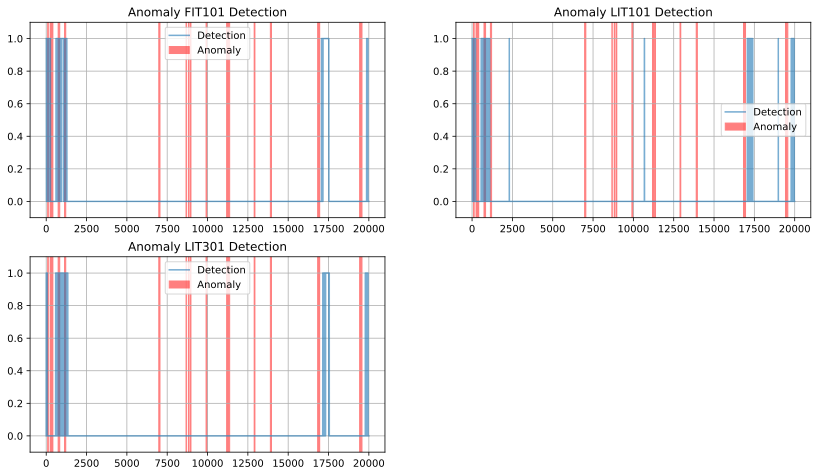

In [130]:
win=20000
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot(np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Detection')
plt.legend()
plt.ylim(-0.1, 1.1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot(np.array([*(new_u[:win, 1] - new_d[:win, 1])]) > lit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot(np.array([*(new_u[:win, 2] - new_d[:win, 2])]) > lit301_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

plt.show()

In [131]:
win=filling.shape[0] - 400
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot(np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Detection')
plt.legend()
plt.ylim(-0.1, 1.1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot(np.array([*(new_u[:win, 1] - new_d[:win, 1])]) > lit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot(np.array([*(new_u[:win, 2] - new_d[:win, 2])]) > lit301_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

plt.show()

In [132]:
y_pred = np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh
y_true = state[:y_pred.shape[0]]

fit101_f1 = f1_score(y_true, y_pred)
fit101_precision = precision_score(y_true, y_pred)
fit101_recall = recall_score(y_true, y_pred)

print('FIT101_F1_SCORE: ', fit101_f1)
print('FIT101_PRECISION_SCORE: ', fit101_precision)
print('FIT101_RECALL_SCORE: ', fit101_recall)

FIT101_F1_SCORE:  0.7027498908773462
FIT101_PRECISION_SCORE:  0.6722899615834308
FIT101_RECALL_SCORE:  0.736100950987564


In [126]:
from TCN import TCN_EncDecAttn

dropout = 0.1
kernel_size = 7
n = 8
hidden_channels = 128
r_seed = 42

input_channels = 3
n_classes = 3 * 5 * 3
channel_sizes = [hidden_channels] * n

device = "cuda" if torch.cuda.is_available() else "cpu"
model_ED = TCN_EncDecAttn(n_classes, input_channels, channel_sizes, kernel_size=kernel_size, dropout=dropout, num_heads=32, device=device).to(device)

In [128]:
model_ED.load_state_dict(torch.load('/content/EncDec_SWaT_prob'))

<All keys matched successfully>

In [135]:
train_check = SWaT_Dataset_Autoformer_TCN(train_data[:, prediction_idx], 400, 3)
test_check = SWaT_Dataset_Autoformer_TCN(test_data[:, prediction_idx], 400, 3)

In [149]:
r = []
g = []
u = []
d = []
xx, y = test_check[0]
x = torch.Tensor(xx).to(device)[None, :399, :]
o = xx
target = torch.Tensor(xx).to(device)[None, 399, :][:, None, :]
model_ED.eval()
print(x.shape, target.shape, o.shape)
for i in range(50):
  _, y = test_check[i]
  result, _ = model_ED(x, target)
  output = result.reshape(1, -1, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  varp = var[0, -1, :]
  exp = expect[0, -1, :]
  temp_q_20 = []
  temp_q_80 = []
  for i in range(3):
    expi = exp[i].item()
    vari = varp[i].item()
    #print(vari)
    #sample = np.random.normal(expi, vari, 200)
    #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
    #print(q_20 - q_80, i)
    #temp_q_20.append(q_20)
    #temp_q_80.append(q_80)
    temp_q_20.append(expi)
    temp_q_80.append(vari)
  #result = torch.normal(expect, var)
  result = expect
  target = torch.cat((target, result[0, -1, :][None, None, :]), dim=1)
  #x = x[:, 1:, :]
  r.append(result[0, -1, :].cpu().detach().numpy())
  g.append(y[-1, :])
  d.append(temp_q_20)
  u.append(temp_q_80)

torch.Size([1, 399, 3]) torch.Size([1, 1, 3]) (400, 3)


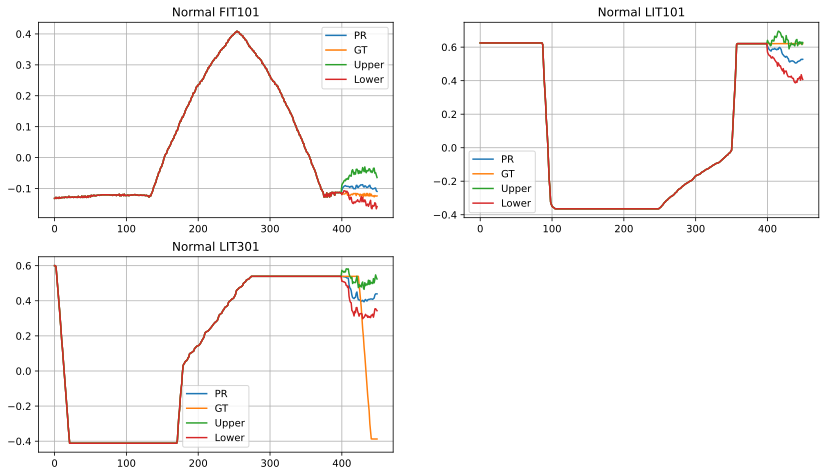

In [150]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 200)
      q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
u = np.array(new_u)
d = np.array(new_d)


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:, 0]], label='PR')
plt.plot([*o[:, 0], *g[:, 0]], label='GT')
plt.plot([*o[:, 0], *u[:, 0]], label='Upper')
plt.plot([*o[:, 0], *d[:, 0]], label='Lower')
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:, 1]], label='PR')
plt.plot([*o[:, 1], *g[:, 1]], label='GT')
plt.plot([*o[:, 1], *u[:, 1]], label='Upper')
plt.plot([*o[:, 1], *d[:, 1]], label='Lower')
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:, 2]], label='PR')
plt.plot([*o[:, 2], *g[:, 2]], label='GT')
plt.plot([*o[:, 2], *u[:, 2]], label='Upper')
plt.plot([*o[:, 2], *d[:, 2]], label='Lower')
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [151]:
r = []
g = []
u = []
d = []
xx, y = test_check[0]
x = torch.Tensor(xx).to(device)[None, :399, :]
o = xx
target = torch.Tensor(xx).to(device)[None, 399, :][:, None, :]
model_ED.eval()
print(x.shape, target.shape, o.shape)
for i in range(len(test_check)):
  _, y = test_check[i]
  if i % 20 == 0:
    xx, _ = test_check[i]
    x = torch.Tensor(xx).to(device)[None, :399, :]
    target = torch.Tensor(xx).to(device)[None, 399, :][:, None, :]
  result, _ = model_ED(x, target)
  output = result.reshape(1, -1, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  varp = var[0, -1, :]
  exp = expect[0, -1, :]
  temp_q_20 = []
  temp_q_80 = []
  for i in range(3):
    expi = exp[i].item()
    vari = varp[i].item()
    #print(vari)
    #sample = np.random.normal(expi, vari, 200)
    #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
    #print(q_20 - q_80, i)
    #temp_q_20.append(q_20)
    #temp_q_80.append(q_80)
    temp_q_20.append(expi)
    temp_q_80.append(vari)
  #result = torch.normal(expect, var)
  result = expect
  target = torch.cat((target, result[0, -1, :][None, None, :]), dim=1)
  #x = x[:, 1:, :]
  r.append(result[0, -1, :].cpu().detach().numpy())
  g.append(y[-1, :])
  d.append(temp_q_20)
  u.append(temp_q_80)

torch.Size([1, 399, 3]) torch.Size([1, 1, 3]) (400, 3)


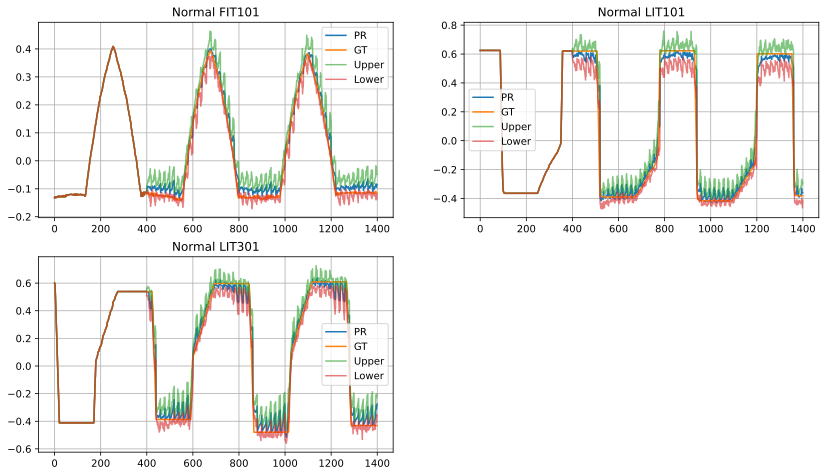

In [152]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:1000, 0]], label='PR')
plt.plot([*o[:, 0], *g[:1000, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:1000, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:1000, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:1000, 1]], label='PR')
plt.plot([*o[:, 1], *g[:1000, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:1000, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:1000, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:1000, 2]], label='PR')
plt.plot([*o[:, 2], *g[:1000, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:1000, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:1000, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [158]:
r = []
g = []
u = []
d = []
xx, y = anomaly_check[0]
x = torch.Tensor(xx).to(device)[None, :399, :]
o = xx
target = torch.Tensor(xx).to(device)[None, 399, :][:, None, :]
model_ED.eval()
print(x.shape, target.shape, o.shape)
for i in range(len(anomaly_check)):
  _, y = anomaly_check[i]
  if i % 20 == 0:
    xx, _ = anomaly_check[i]
    x = torch.Tensor(xx).to(device)[None, :399, :]
    target = torch.Tensor(xx).to(device)[None, 399, :][:, None, :]
  result, _ = model_ED(x, target)
  output = result.reshape(1, -1, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  varp = var[0, -1, :]
  exp = expect[0, -1, :]
  temp_q_20 = []
  temp_q_80 = []
  for i in range(3):
    expi = exp[i].item()
    vari = varp[i].item()
    #print(vari)
    #sample = np.random.normal(expi, vari, 200)
    #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
    #print(q_20 - q_80, i)
    #temp_q_20.append(q_20)
    #temp_q_80.append(q_80)
    temp_q_20.append(expi)
    temp_q_80.append(vari)
  #result = torch.normal(expect, var)
  result = expect
  target = torch.cat((target, result[0, -1, :][None, None, :]), dim=1)
  #x = x[:, 1:, :]
  r.append(result[0, -1, :].cpu().detach().numpy())
  g.append(y[-1, :])
  d.append(temp_q_20)
  u.append(temp_q_80)

torch.Size([1, 399, 3]) torch.Size([1, 1, 3]) (400, 3)


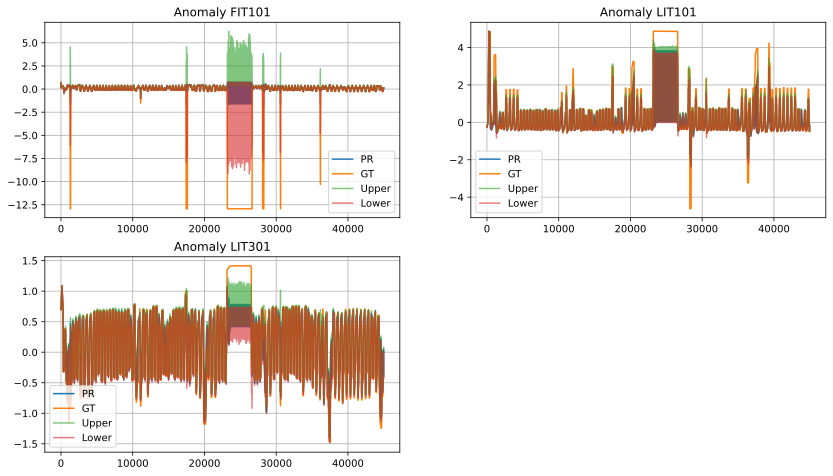

In [159]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:, 0]], label='PR')
plt.plot([*o[:, 0], *g[:, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:, 0]], label='Lower', alpha=0.6)
plt.title('Anomaly FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:, 1]], label='PR')
plt.plot([*o[:, 1], *g[:, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:, 1]], label='Lower', alpha=0.6)
plt.title('Anomaly LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:, 2]], label='PR')
plt.plot([*o[:, 2], *g[:, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:, 2]], label='Lower', alpha=0.6)
plt.title('Anomaly LIT301')
plt.legend()
plt.grid()

plt.show()

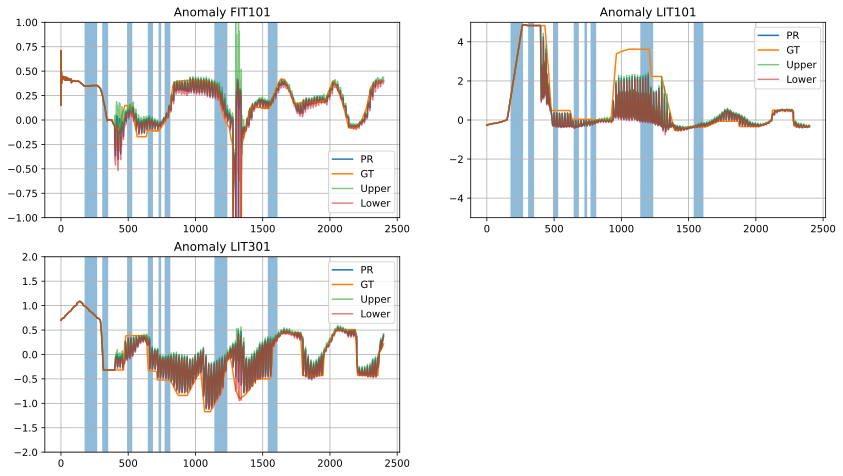

In [161]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

win = 2000


fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:win, 0]], label='PR')
plt.plot([*o[:, 0], *g[:win, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:win, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:win, 0]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly FIT101')
plt.legend()
plt.ylim(-1, 1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:win, 1]], label='PR')
plt.plot([*o[:, 1], *g[:win, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:win, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:win, 1]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT101')
plt.ylim(-5, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:win, 2]], label='PR')
plt.plot([*o[:, 2], *g[:win, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:win, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:win, 2]], label='Lower', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT301')
plt.ylim(-2, 2)
plt.legend()
plt.grid()

plt.show()

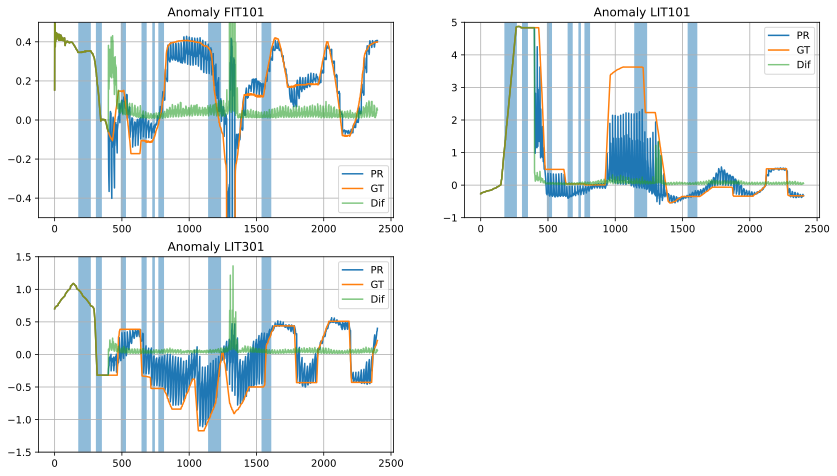

In [162]:
fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:win, 0]], label='PR')
plt.plot([*o[:, 0], *g[:win, 0]], label='GT')
plt.plot([*o[:, 0], *(new_u[:win, 0] - new_d[:win, 0])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly FIT101')
plt.legend()
plt.ylim(-0.5, 0.5)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:win, 1]], label='PR')
plt.plot([*o[:, 1], *g[:win, 1]], label='GT')
plt.plot([*o[:, 1], *(new_u[:win, 1] - new_d[:win, 1])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT101')
plt.ylim(-1, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:win, 2]], label='PR')
plt.plot([*o[:, 2], *g[:win, 2]], label='GT')
plt.plot([*o[:, 2], *(new_u[:win, 2] - new_d[:win, 2])], label='Dif', alpha=0.6)
plt.fill(np.arange(win + 400), filling[:win + 400], alpha=0.5)
plt.title('Anomaly LIT301')
plt.ylim(-1.5, 1.5)
plt.legend()
plt.grid()

plt.show()

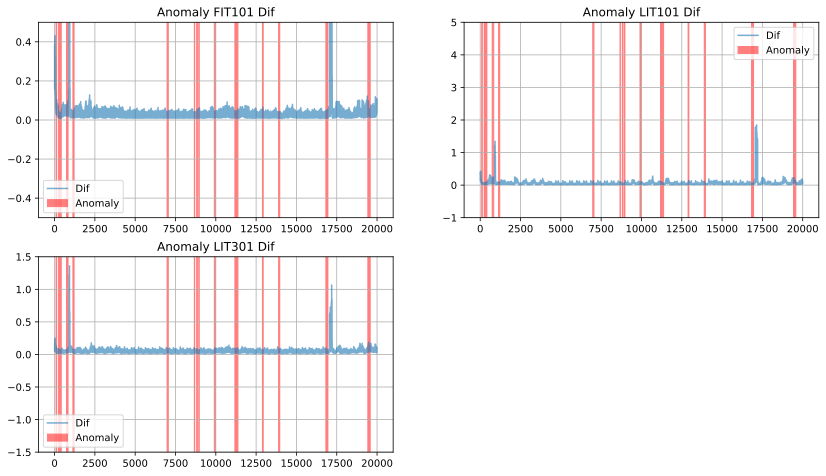

In [163]:
win=20000
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*(new_u[:win, 0] - new_d[:win, 0])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Dif')
plt.legend()
plt.ylim(-0.5, 0.5)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*(new_u[:win, 1] - new_d[:win, 1])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Dif')
plt.ylim(-1, 5)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*(new_u[:win, 2] - new_d[:win, 2])], label='Dif', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Dif')
plt.ylim(-1.5, 1.5)
plt.legend()
plt.grid()

plt.show()

In [164]:
fit101_thresh = 0.2
lit101_thresh = 1
lit301_thresh = 0.5

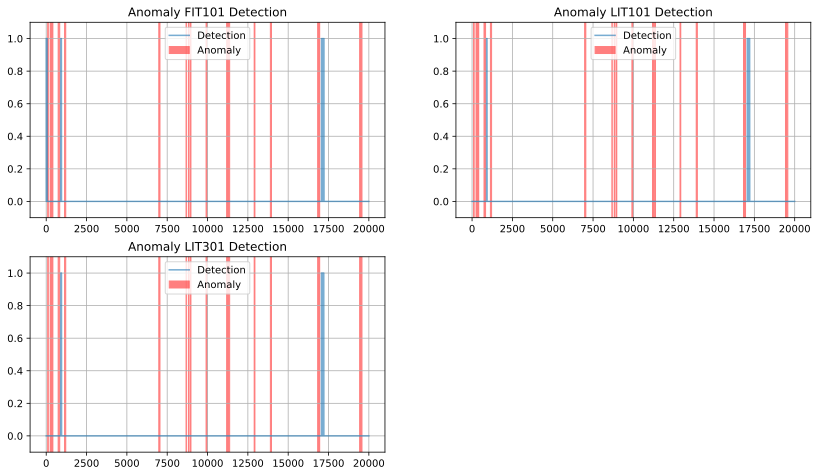

In [165]:
win=20000
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot(np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Detection')
plt.legend()
plt.ylim(-0.1, 1.1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot(np.array([*(new_u[:win, 1] - new_d[:win, 1])]) > lit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot(np.array([*(new_u[:win, 2] - new_d[:win, 2])]) > lit301_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

plt.show()

In [166]:
win=filling.shape[0] - 400
filling_c = filling[400: ]

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot(np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly FIT101 Detection')
plt.legend()
plt.ylim(-0.1, 1.1)
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot(np.array([*(new_u[:win, 1] - new_d[:win, 1])]) > lit101_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win],c='r', alpha=0.5, label='Anomaly')
plt.title('Anomaly LIT101 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot(np.array([*(new_u[:win, 2] - new_d[:win, 2])]) > lit301_thresh, label='Detection', alpha=0.6)
plt.fill(np.arange(win), filling_c[:win], alpha=0.5, label='Anomaly', c='r')
plt.title('Anomaly LIT301 Detection')
plt.ylim(-0.1, 1.1)
plt.legend()
plt.grid()

plt.show()

In [167]:
y_pred = np.array([*(new_u[:win, 0] - new_d[:win, 0])]) > fit101_thresh
y_true = state[:y_pred.shape[0]]

fit101_f1 = f1_score(y_true, y_pred)
fit101_precision = precision_score(y_true, y_pred)
fit101_recall = recall_score(y_true, y_pred)

print('FIT101_F1_SCORE: ', fit101_f1)
print('FIT101_PRECISION_SCORE: ', fit101_precision)
print('FIT101_RECALL_SCORE: ', fit101_recall)

FIT101_F1_SCORE:  0.18094011590470058
FIT101_PRECISION_SCORE:  0.7553763440860215
FIT101_RECALL_SCORE:  0.1027798098024872


In [16]:
from TimesNet import Model

train_dataset = SWaT_Dataset_Autoformer(train_data[:, prediction_idx], 10, 400, 3)
test_dataset = SWaT_Dataset_Autoformer(test_data[:, prediction_idx], 10, 400, 3)

class TN_prob(nn.Module):
  def __init__(self, seq_len, label_len, pred_len, input_dim, c_out, d_model):
    super(TN_prob, self).__init__()

    self.TN = Model(seq_len, label_len, pred_len, input_dim, d_model, d_model=d_model)
    self.fc = nn.Linear(d_model, c_out)
  
  def forward(self, x):
    output = self.TN(x)
    output = self.fc(output)

    return output

In [17]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model_TN = TN_prob(400, 400, 10, 3, 45, d_model=64).to(device).float()

In [18]:
model_TN.load_state_dict(torch.load('/content/TN_SWaT_prob'))

<All keys matched successfully>

In [19]:
r = []
g = []
u = []
d = []
x, y = test_dataset[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :].double()
model_TN.eval()
model_TN.to(device)
for k in range(1):
  _, y = test_dataset[k*10]
  result = model_TN(x.to(device).float())
  output = result.reshape(-1, 10, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  temp_q_20 = []
  temp_q_80 = []
  for b in range(10):
    varp = var[0, -1, :]
    exp = expect[0, -1, :]
    temp_q_20_t = []
    temp_q_80_t = []
    for i in range(3):
      expi = exp[i].item()
      vari = varp[i].item()
      #print(vari)
      #sample = np.random.normal(expi, vari, 200)
      #q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      #print(q_20 - q_80, i)
      temp_q_20_t.append(expi)
      temp_q_80_t.append(vari)
    
    temp_q_20.append(temp_q_20_t)
    temp_q_80.append(temp_q_80_t)
  #result = torch.normal(expect, var)
  result = expect
  d.append(temp_q_20)
  u.append(temp_q_80)
  x = torch.cat((x, result), dim=1)
  x = x[:, 10:, :]
  r.append(result.cpu().detach().numpy())
  g.append(y)

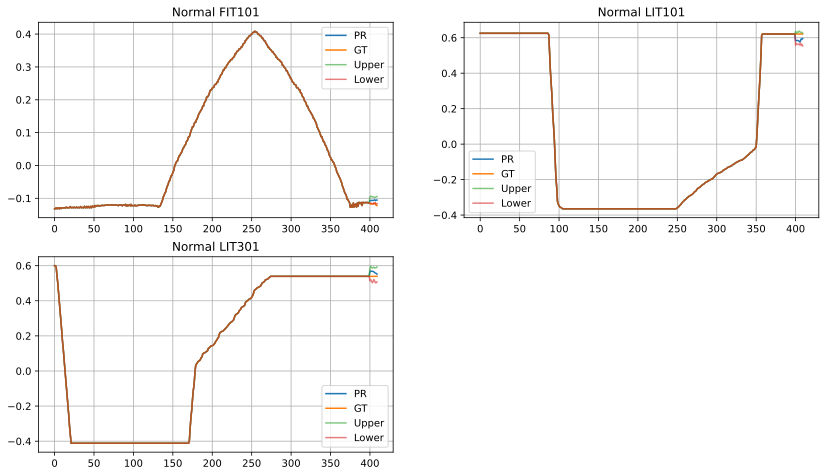

In [20]:
g = np.array(g)
r = np.array(r)
u = np.array(u)
d = np.array(d)

r = r.reshape(10, 3)
g = g.reshape(10, 3)
u = u.reshape(10, 3)
d = d.reshape(10, 3)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.1, 0.9])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:1000, 0]], label='PR')
plt.plot([*o[:, 0], *g[:1000, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:1000, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:1000, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:1000, 1]], label='PR')
plt.plot([*o[:, 1], *g[:1000, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:1000, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:1000, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:1000, 2]], label='PR')
plt.plot([*o[:, 2], *g[:1000, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:1000, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:1000, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [21]:
r = []
g = []
u = []
d = []
x, y = test_dataset[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :].double()
for i in range(len(test_check) // 10):
  if i % 2 == 0:
    x, _ = test_dataset[i*10]
    x = torch.Tensor(x).to(device)[None, :, :].double()
  _, y = test_dataset[i*10]
  result = model_TN(x)
  output = result.reshape(-1, 10, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  temp_q_20 = []
  temp_q_80 = []
  for b in range(10):
    varp = var[0, -1, :]
    exp = expect[0, -1, :]
    temp_q_20_t = []
    temp_q_80_t = []
    for i in range(3):
      expi = exp[i].item()
      vari = varp[i].item()
      #print(vari)
      #sample = np.random.normal(expi, vari, 200)
      #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      #print(q_20 - q_80, i)
      #temp_q_20_t.append(q_20)
      #temp_q_80_t.append(q_80)
      temp_q_20_t.append(expi)
      temp_q_80_t.append(vari)
    
    temp_q_20.append(temp_q_20_t)
    temp_q_80.append(temp_q_80_t)
  #result = torch.normal(expect, var)
  result = expect
  #if result[0, -1, -1] > 0:
  #  result[0, -1, -1] = 0
  #else:
  #  result[0, -1, -1] = 0
  x = torch.cat((x, result), dim=1)
  x = x[:, 10:, :]
  r.append(result.cpu().detach().numpy())
  g.append(y)
  d.append(temp_q_20)
  u.append(temp_q_80)

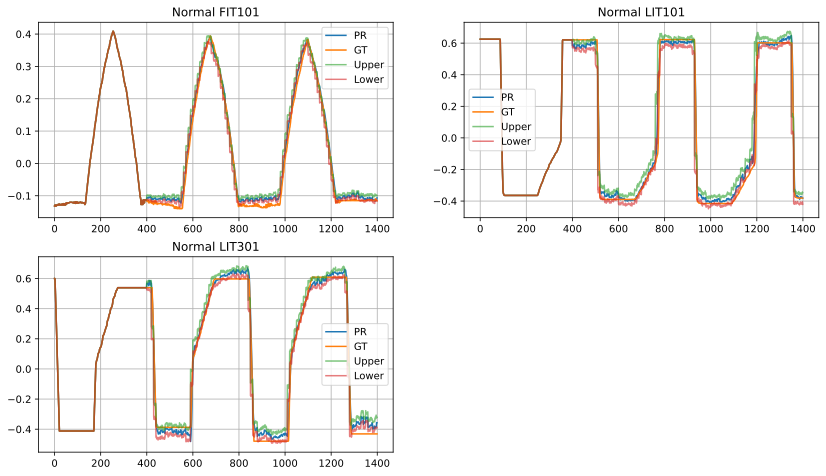

In [22]:
g = np.array(g).reshape(-1, 3)
r = np.array(r).reshape(-1, 3)
u = np.array(u).reshape(-1, 3)
d = np.array(d).reshape(-1, 3)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:1000, 0]], label='PR')
plt.plot([*o[:, 0], *g[:1000, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:1000, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:1000, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:1000, 1]], label='PR')
plt.plot([*o[:, 1], *g[:1000, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:1000, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:1000, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:1000, 2]], label='PR')
plt.plot([*o[:, 2], *g[:1000, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:1000, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:1000, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

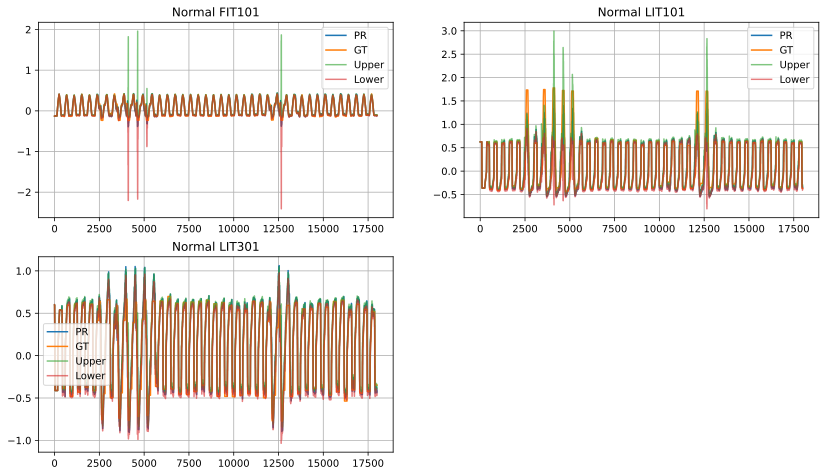

In [23]:
g = np.array(g).reshape(-1, 3)
r = np.array(r).reshape(-1, 3)
u = np.array(u).reshape(-1, 3)
d = np.array(d).reshape(-1, 3)

new_u = []
new_d = []

for i in range(len(u)):
    temp_q_20 = []
    temp_q_80 = []
    for j in range(3):
      expi = d[i, j].item()
      vari = u[i, j].item()
      sample = np.random.normal(expi, vari, 100)
      q_20, q_80 = np.quantile(sample, [0.2, 0.8])
      temp_q_20.append(q_20)
      temp_q_80.append(q_80)
    new_d.append(temp_q_20)
    new_u.append(temp_q_80)
  
new_u = np.array(new_u)
new_d = np.array(new_d)

fig = plt.figure(figsize=(14, 12))
fig.add_subplot(3, 2, 1)
plt.plot([*o[:, 0], *r[:, 0]], label='PR')
plt.plot([*o[:, 0], *g[:, 0]], label='GT')
plt.plot([*o[:, 0], *new_u[:, 0]], label='Upper', alpha=0.6)
plt.plot([*o[:, 0], *new_d[:, 0]], label='Lower', alpha=0.6)
plt.title('Normal FIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 2)
plt.plot([*o[:, 1], *r[:, 1]], label='PR')
plt.plot([*o[:, 1], *g[:, 1]], label='GT')
plt.plot([*o[:, 1], *new_u[:, 1]], label='Upper', alpha=0.6)
plt.plot([*o[:, 1], *new_d[:, 1]], label='Lower', alpha=0.6)
plt.title('Normal LIT101')
plt.legend()
plt.grid()

fig.add_subplot(3, 2, 3)
plt.plot([*o[:, 2], *r[:, 2]], label='PR')
plt.plot([*o[:, 2], *g[:, 2]], label='GT')
plt.plot([*o[:, 2], *new_u[:, 2]], label='Upper', alpha=0.6)
plt.plot([*o[:, 2], *new_d[:, 2]], label='Lower', alpha=0.6)
plt.title('Normal LIT301')
plt.legend()
plt.grid()

plt.show()

In [24]:
r = []
g = []
u = []
d = []
x, y = anomaly_dataset[0]
o = x
x = torch.Tensor(x).to(device)[None, :, :].double()
for i in range(len(anomaly_dataset) // 10):
  if i % 2 == 0:
    x, _ = anomaly_dataset[i*10]
    x = torch.Tensor(x).to(device)[None, :, :].double()
  _, y = anomaly_dataset[i*10]
  result = model_TN(x)
  output = result.reshape(-1, 10, 3, 5, 3)
  output[:, :, :, :, -1] = torch.nn.Softmax(dim=-1)(output[:, :, :, :, -1])
  expect = (output[:, :, :, :, 0] * output[:, :, :, :, -1]).sum(dim=-1)
  var = ((torch.nn.ELU()(output[:, :, :, :, 1]) + 1) * output[:, :, :, :, -1]).sum(dim=-1)
  #plt.plot(result[0, :, 0].cpu().detach(), label=f'{i}')
  #print(x.shape)
  #print(var.shape)
  temp_q_20 = []
  temp_q_80 = []
  for b in range(10):
    varp = var[0, -1, :]
    exp = expect[0, -1, :]
    temp_q_20_t = []
    temp_q_80_t = []
    for i in range(3):
      expi = exp[i].item()
      vari = varp[i].item()
      #print(vari)
      #sample = np.random.normal(expi, vari, 200)
      #q_20, q_80 = np.quantile(sample, [0.01, 0.99])
      #print(q_20 - q_80, i)
      #temp_q_20_t.append(q_20)
      #temp_q_80_t.append(q_80)
      temp_q_20_t.append(expi)
      temp_q_80_t.append(vari)
    
    temp_q_20.append(temp_q_20_t)
    temp_q_80.append(temp_q_80_t)
  #result = torch.normal(expect, var)
  result = expect
  #if result[0, -1, -1] > 0:
  #  result[0, -1, -1] = 0
  #else:
  #  result[0, -1, -1] = 0
  x = torch.cat((x, result), dim=1)
  x = x[:, 10:, :]
  r.append(result.cpu().detach().numpy())
  g.append(y)
  d.append(temp_q_20)
  u.append(temp_q_80)

OutOfMemoryError: ignored